In [ ]:
%config Completer.use_jedi = False
import scanpy as sc
import pandas as pd
sc.set_figure_params(dpi = 150)
from matplotlib import pyplot as plt
import seaborn as sns
import os

import matplotlib.pyplot as plt

# create a color dictionary for tissues
def tissue_colors():
    
    tissue_color_dict = {'Bladder': '#e7969c',
             'Blood': '#d6616b',
             'Bone_Marrow': '#cedb9c',
             'Eye': '#c7ea46',#"#00ff7f",
             'Fat': '#e7cb94',
             'Heart': '#ff0800',
             'Kidney': '#7b4173',
             'Large_Intestine': '#31a354',
             'Liver': '#000080',
             'Lung': '#3182bd',
             'Lymph_Node': '#8c6d31',
             'Mammary':'#ce6dbd',
             'Muscle': '#e7ba52',
             'Pancreas': '#fd8d3c',
             'Prostate':'#637939',#'#a55194',#
             'Salivary_Gland':'#622a0f',
             'Skin': '#de9ed6',
             'Small_Intestine': '#6baed6',
             'Spleen': '#393b79',
             'Thymus': '#9c9ede',
             'Tongue':'#b5cf6b',
             'Trachea': '#969696',
             'Uterus':'#c64b8c',#'#ff0090',
             'Vasculature': '#843c39'}
    
    return tissue_color_dict



def _pp(adata, log, normalize, remove_dissociation):
    if normalize:
        sc.pp.normalize_total(adata)
    if log:
        sc.pp.log1p(adata, chunk_size=50000)
        adata.raw = adata 

    if remove_dissociation:
    #mouse2human = pd.read_csv('../metadata/mouse2human.csv')
        dissociation_genes = pd.read_csv('../metadata/Mouse2Human_dissociation_genes.csv')
        adata.var['not_dissociation_gene'] = ~adata.var.index.isin(dissociation_genes['Human gene name'])
        adata = adata[:, adata.var.not_dissociation_gene == True]
    return adata







In [2]:
tissue_colors_dictionary = tissue_colors()


cell_label = 'cell_ontology_class'


# cannot currently read this object because it kills my kernel
adata = sc.read_h5ad('../../data/TSP1_TSP15_scvi_donor-method_normalized-log1p-scaled_annotated.h5ad', backed='r+')

# subset to circulating cell types
cell_types_in_Blood = adata.obs.groupby('tissue')[cell_label].value_counts().xs('Blood')
circulating_cell_types = cell_types_in_Blood[cell_types_in_Blood > 30]

adata = adata[adata.obs.cell_ontology_class.isin(circulating_cell_types.index)]


adata = adata.to_memory()


adata = _pp(adata, True, True, False)

In [3]:
adata.obs.cell_ontology_class.value_counts()

macrophage                                                     36875
memory b cell                                                  15749
neutrophil                                                     15091
classical monocyte                                             14141
cd4-positive, alpha-beta t cell                                14077
monocyte                                                       12524
cd8-positive, alpha-beta t cell                                12493
plasma cell                                                    11593
erythrocyte                                                    11021
nk cell                                                         9037
naive b cell                                                    6818
type i nk t cell                                                5314
cd4-positive, alpha-beta memory t cell                          4540
naive thymus-derived cd4-positive, alpha-beta t cell            3264
cd8-positive, alpha-beta cytokine 

In [4]:
# start iterating through the cell types 
cell_type = 'macrophage'

_sub_adata = adata[adata.obs.cell_ontology_class == cell_type]

In [5]:
label = 'tissue'

In [6]:
# subset to tissues with more than 10 members of this particular cell class
_df = pd.DataFrame(_sub_adata.obs.groupby(label)[cell_label].value_counts() > 10)

_tissues = _df[_df.cell_ontology_class == True].unstack().index.to_list()

_sub_adata = _sub_adata[_sub_adata.obs.tissue.isin(_tissues)]

In [7]:
_tissues

['Bladder',
 'Blood',
 'Bone_Marrow',
 'Eye',
 'Fat',
 'Heart',
 'Kidney',
 'Liver',
 'Lung',
 'Lymph_Node',
 'Mammary',
 'Muscle',
 'Prostate',
 'Salivary_Gland',
 'Skin',
 'Spleen',
 'Thymus',
 'Trachea',
 'Uterus',
 'Vasculature']

In [8]:
sc.tl.rank_genes_groups(_sub_adata, groupby=label, method='wilcoxon')

sc.tl.filter_rank_genes_groups(_sub_adata, min_fold_change=0.5)

Trying to set attribute `.uns` of view, copying.


In [ ]:
tissue_colors_dictionary

/home/michaelswift/miniconda3/envs/scirpy/lib/python3.8/site-packages/seaborn/axisgrid.py:392: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(nrow, ncol, **kwargs)


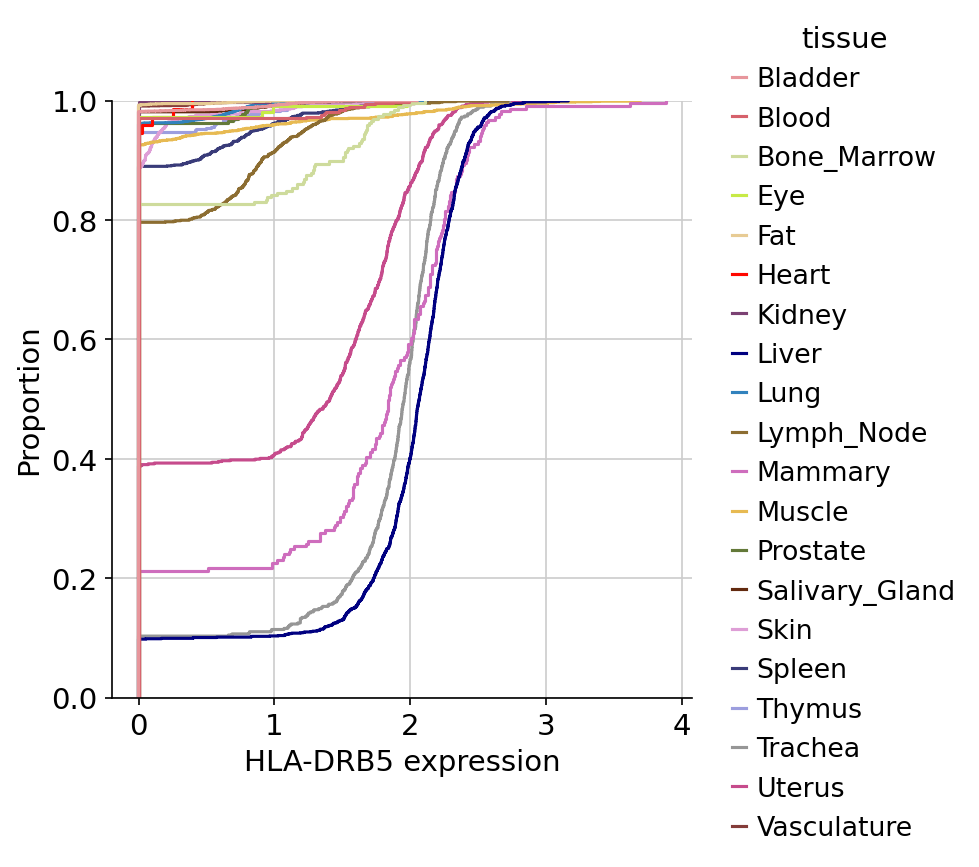

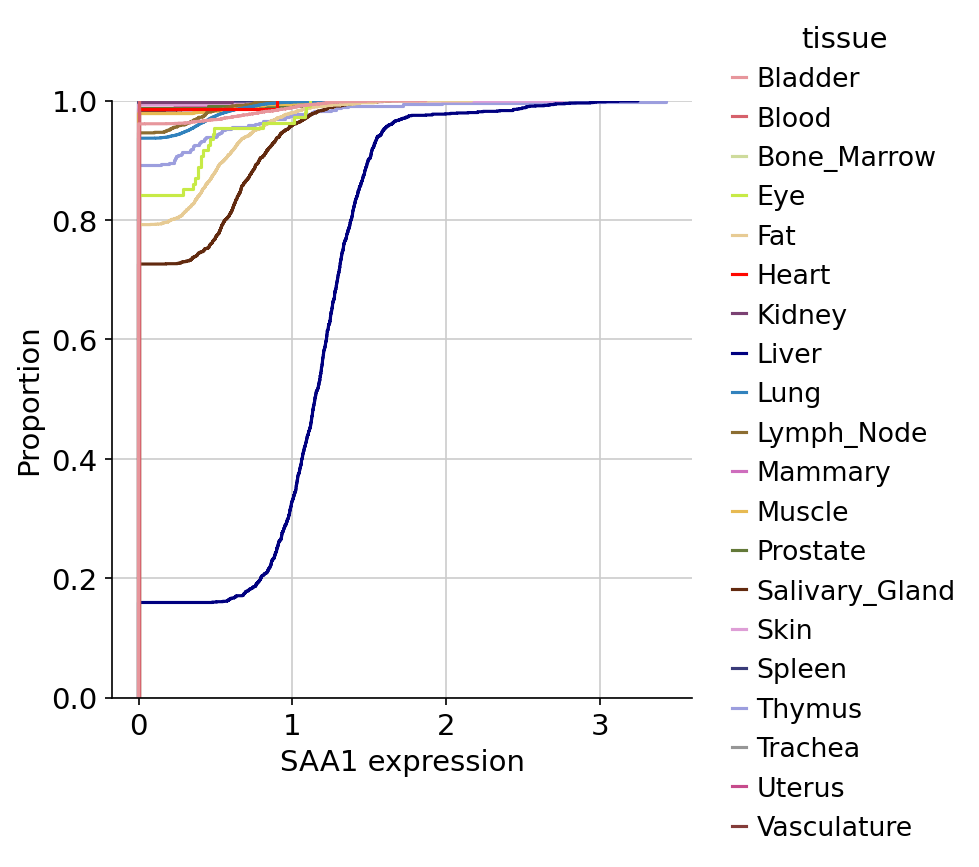

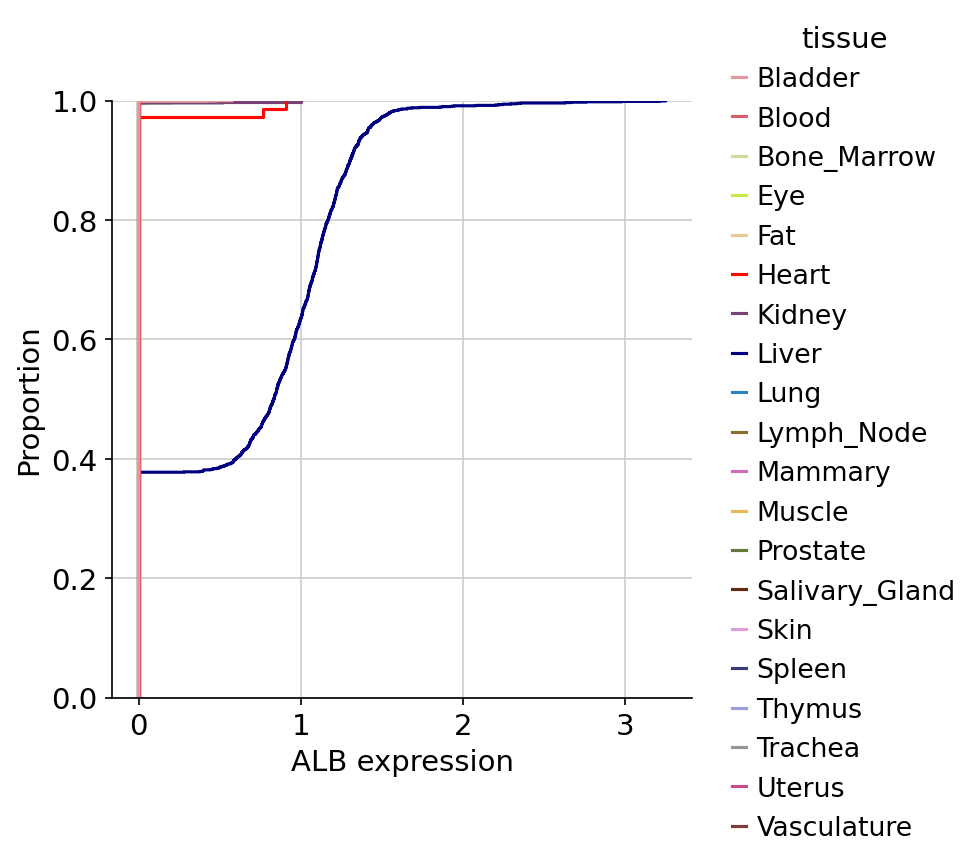

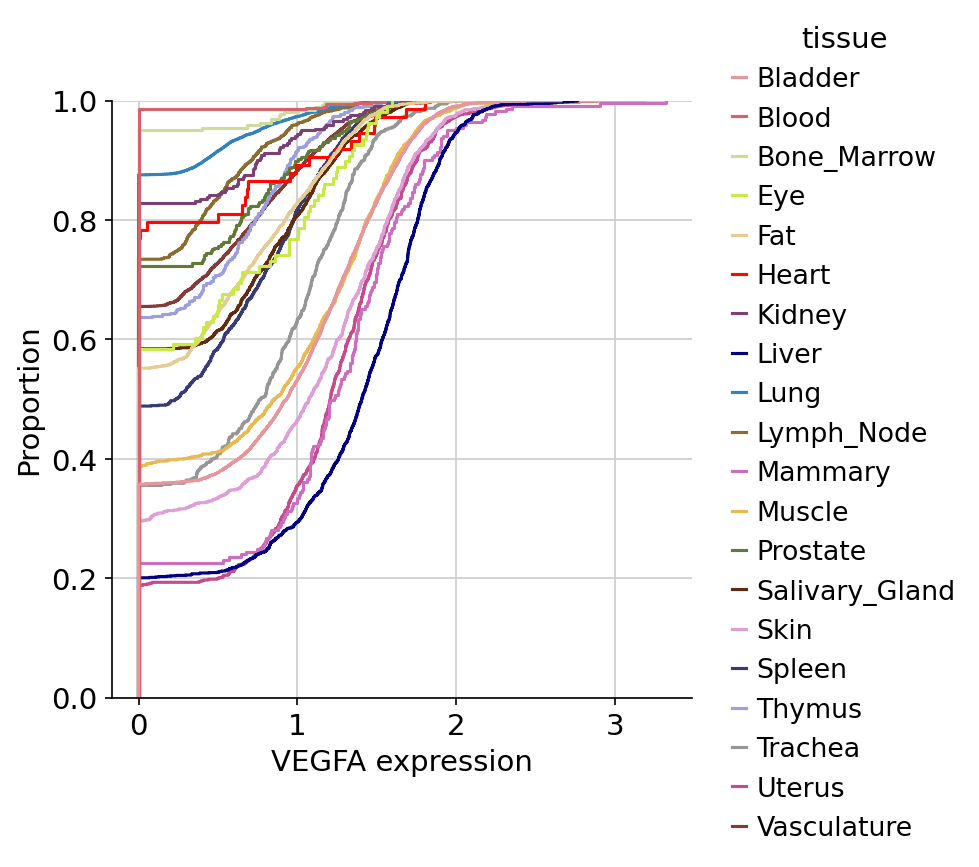

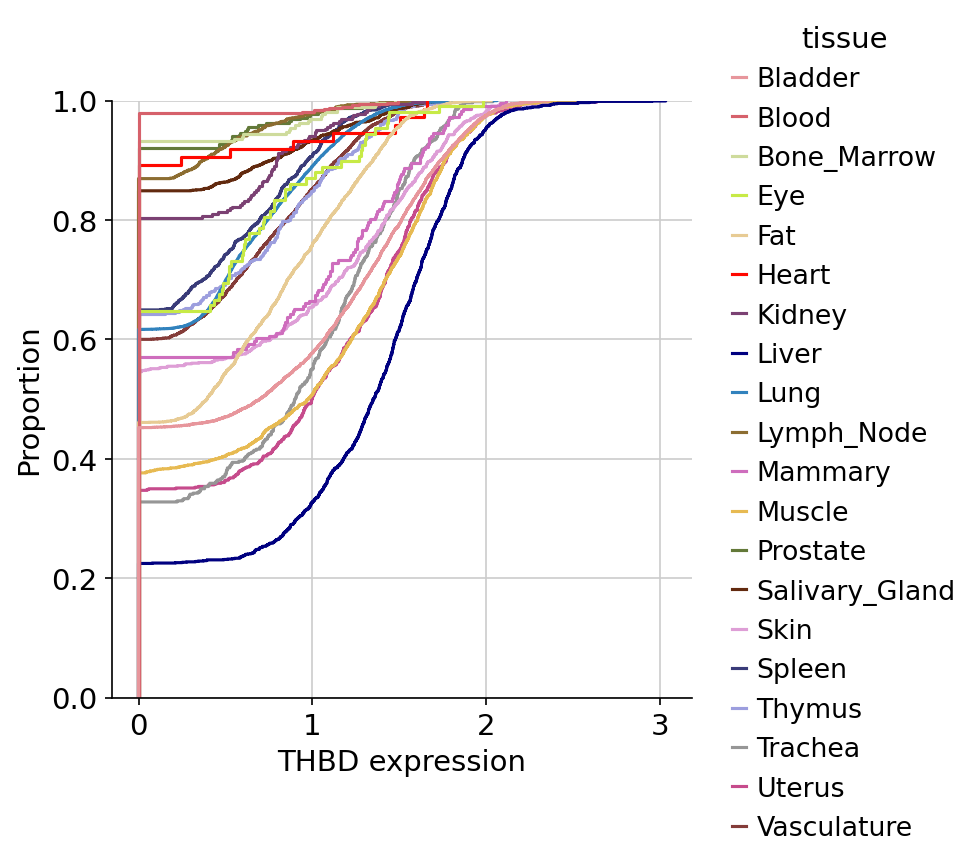

...

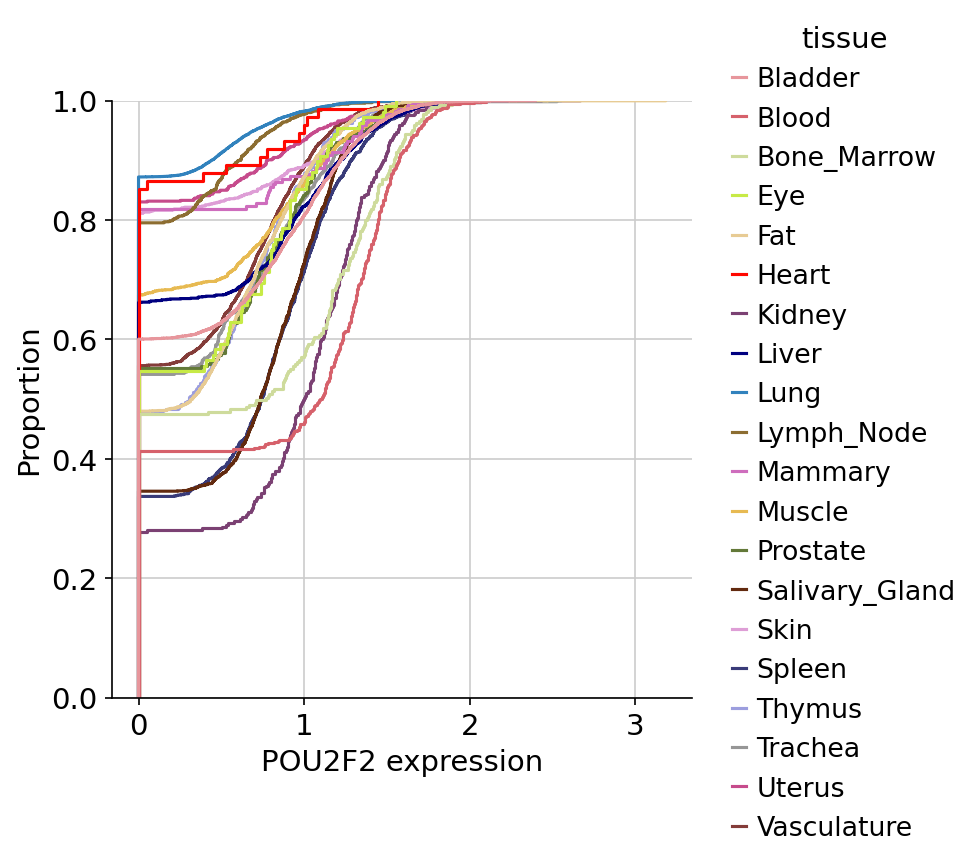

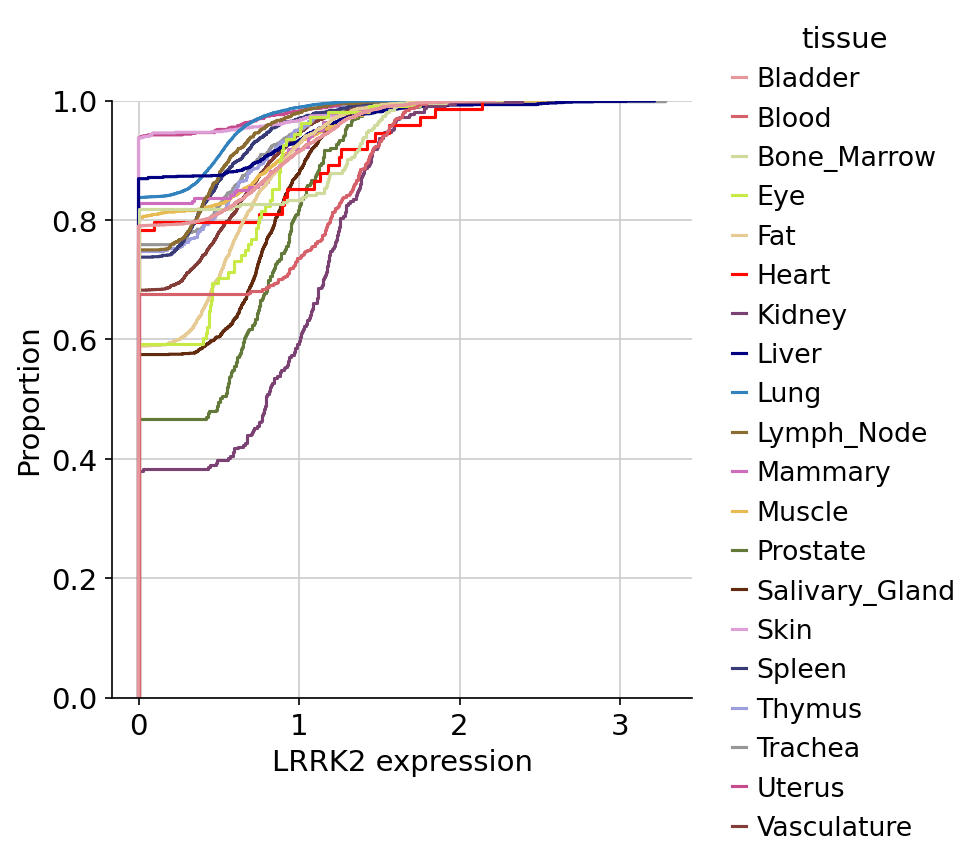

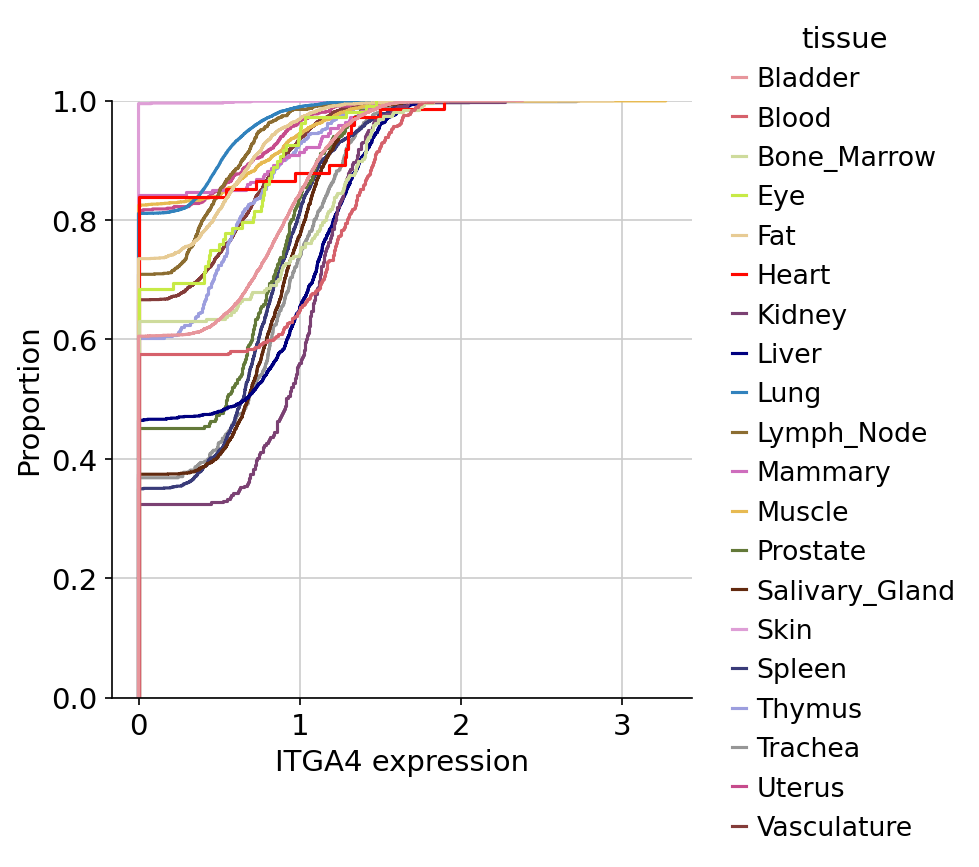

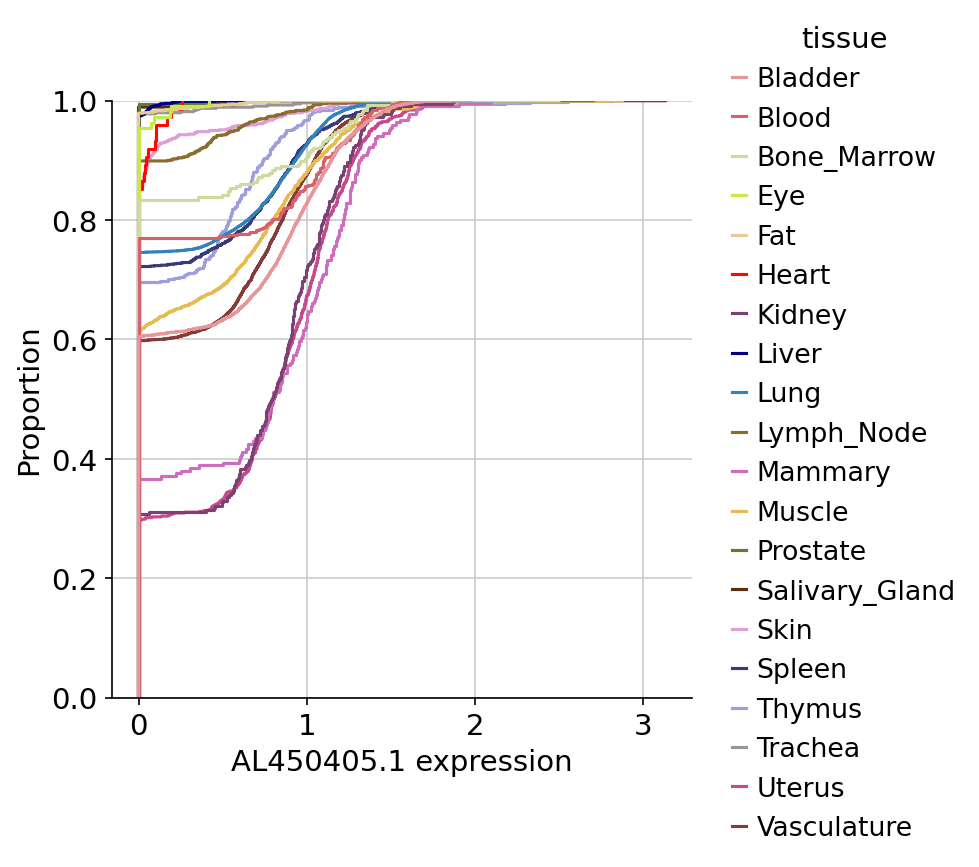

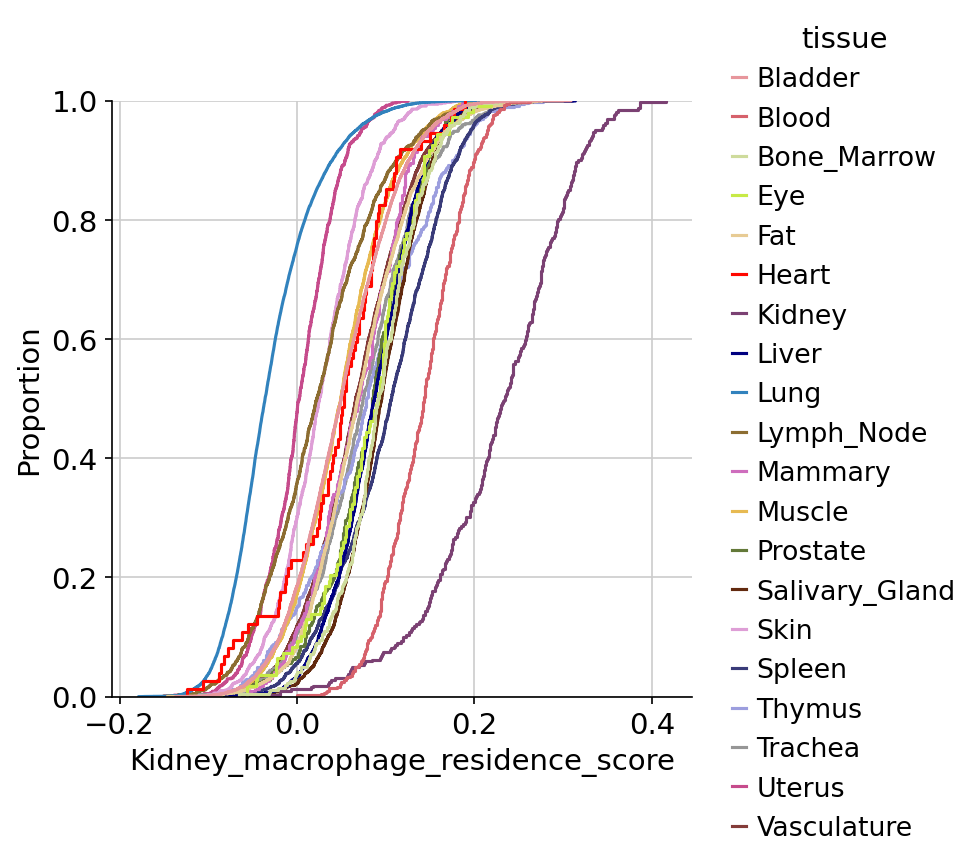

In [22]:
holo_gene_set = []
result = _sub_adata.uns['rank_genes_groups_filtered']
groups = result['names'].dtype.names
gene_df = pd.DataFrame(
    {group + '_' + key[:]: result[key][group]
     # Get Each Clusters 10 top Genes
    for group in groups for key in ['names', 'pvals']})


#iterate thru the unique tissues
for tis in _sub_adata.obs[label].unique():

    # reset rank genes df for new organ
    _gene_df = gene_df.copy()
     # Drop the filtered genes
    _gene_df = _gene_df[[tis + '_names', tis + '_pvals']].dropna()
    gene_list = _gene_df[tis + '_names'].to_list()
    genes = gene_list
    holo_gene_set.append(gene_list)
    score_name = tis + '_' + cell_type + "_residence_score"
    sc.tl.score_genes(_sub_adata, gene_list = gene_list, score_name = score_name, use_raw = False)
    plotdf = sc.get.obs_df(
            _sub_adata,
            keys=genes +[label, score_name])
    for gene in genes[:10]:
        g = sns.displot(data = plotdf, x = gene, hue = label, kind='ecdf', palette=tissue_colors_dictionary
                       )
        g.set_titles(cell_type)
        g.set_xlabels(gene + ' expression')
        directory = 'figures/{}_specific/{}_{}/'.format(label, cell_type, tis)
        if not os.path.exists(directory):
            os.makedirs(directory)
        g.savefig('figures/{}_specific/{}_{}/{}.png'.format(label, cell_type, tis, gene))
    g = sns.displot(data = plotdf, x=score_name, hue = label, kind = 'ecdf', palette=tissue_colors_dictionary)
    g.savefig('figures/{}_specific/{}'.format(label, score_name))

# Save Results

In [12]:
# doesn't currently work.. 
#_sub_adata.write_h5ad('macrophage_tissue_distinguishing')

In [13]:
flat_list = [item for sublist in holo_gene_set for item in sublist]

In [16]:
_sub_adata.obs.subtissue.value_counts()

nan                   28113
SCAT                   1514
MAT                    1293
Parotid                1124
CoronaryArteries        805
Submandibular           637
Distal                  601
AortaVeneCava           589
Endometrium             460
Diaphragm               350
Proximal                260
Abdomen                 237
Myometrium              234
Supradiaphagmatic       109
abdomen                 103
chest                    87
diaphragm                83
rectusabdominus          70
Sclera-etc               60
Chest                    38
Atria                    25
Ventricle                23
Cornea-etc               20
atria                    13
ventricle                13
Inguinal                  4
lacrimalgland             3
noCornea                  3
whole                     2
supradiaphragmatic        1
Neuroretina-etc           1
Name: subtissue, dtype: int64

In [19]:
_sub_adata.obs.tissue.value_counts()

Lung              13118
Bladder            5338
Vasculature        3301
Fat                2807
Muscle             2024
Salivary_Gland     1761
Liver              1499
Spleen             1335
Lymph_Node         1148
Skin                980
Uterus              766
Trachea             543
Blood               488
Thymus              461
Kidney              321
Prostate            317
Bone_Marrow         265
Mammary             221
Eye                 108
Heart                74
Name: tissue, dtype: int64

In [17]:
pd.DataFrame(flat_list).to_csv(cell_type + "tissue_distinguishing_genes.csv")

## Re load the data 

In [7]:
df = pd.read_csv(cell_type + 'tissue_distinguishing_genes.csv', index_col=0)

In [11]:
df.iloc[:,0]

0        HLA-DRB5
1            SAA1
2             ALB
3           VEGFA
4            THBD
           ...   
12696       QSER1
12697     WAC-AS1
12698        INIP
12699       CASC3
12700       SLMAP
Name: 0, Length: 12701, dtype: object

# PCA

In [13]:
# cannot currently read this object because it kills my kernel
cell_type = 'macrophage'
"""adata = sc.read_h5ad('../../data/TSP1_TSP15_scvi_donor-method_normalized-log1p-scaled_annotated.h5ad', backed='r+')

adata = adata[adata.obs.cell_ontology_class == cell_type]

adata = adata.to_memory()
adata = adata[~adata.obs.tissue.isin(['Salivary_Gland', 'Heart', 'Eye'])]
"""
subset = True 
if subset:
    adata = adata[:,adata.var.index.isin(df.iloc[:,0])]

def _pp(adata, log, normalize, remove_dissociation):
    if normalize:
        sc.pp.normalize_total(adata)
    if log:
        sc.pp.log1p(adata, chunk_size=50000)
        adata.raw = adata 

    if remove_dissociation:
    #mouse2human = pd.read_csv('../metadata/mouse2human.csv')
        dissociation_genes = pd.read_csv('../metadata/Mouse2Human_dissociation_genes.csv')
        adata.var['not_dissociation_gene'] = ~adata.var.index.isin(dissociation_genes['Human gene name'])
        adata = adata[:, adata.var.not_dissociation_gene == True]
    return adata

adata = _pp(adata, True, True, False)

/home/michaelswift/miniconda3/envs/scirpy/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


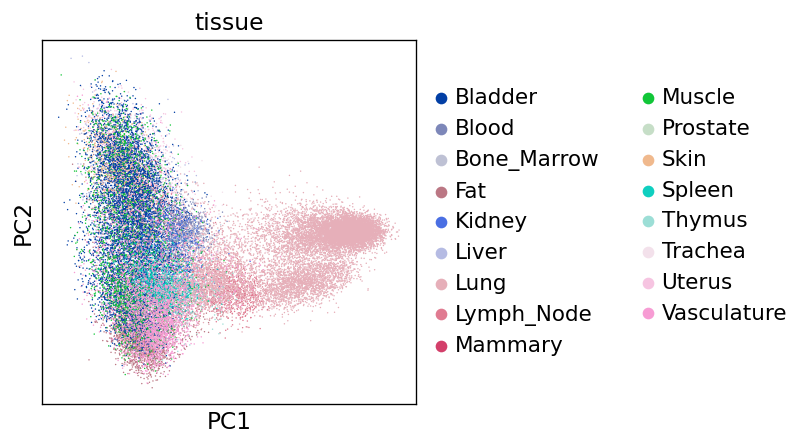

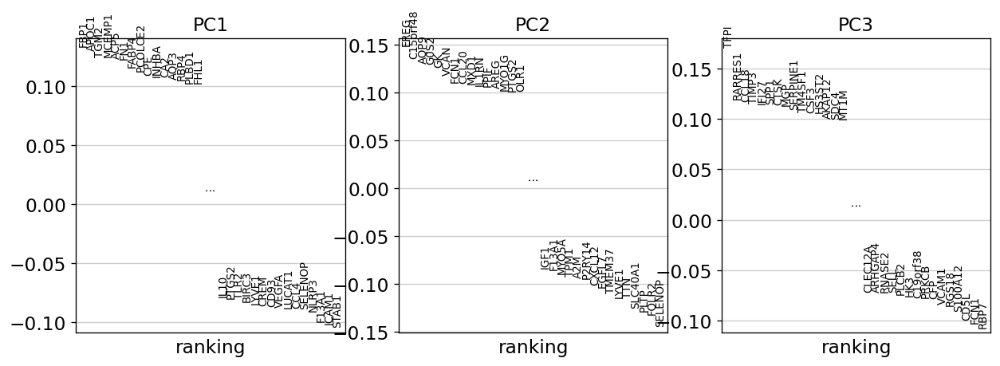

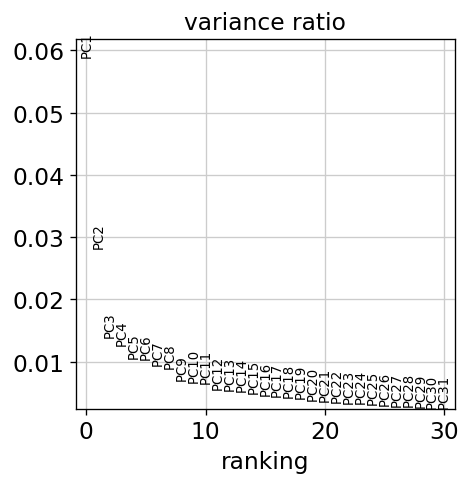

In [14]:
sc.pp.scale(adata)

sc.pp.pca(adata)

sc.pl.pca_overview(adata, color = ['tissue'], projection = '2d', size = 3)

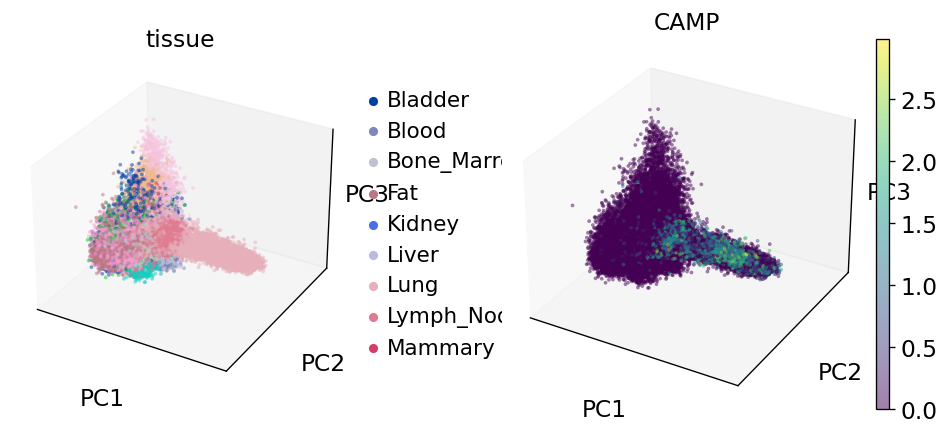

In [15]:
sc.pl.pca(adata, color = ['tissue', 'CAMP'], add_outline=False, projection = '3d', size=60, alpha = 0.5)

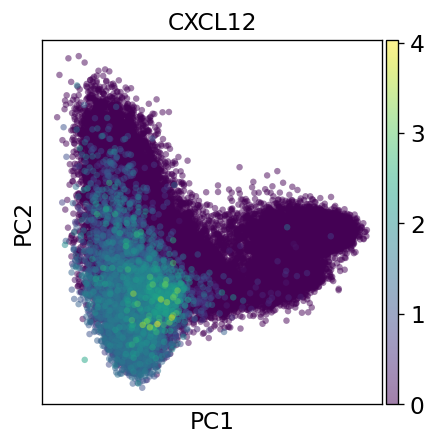

In [16]:
sc.pl.pca(adata, color = ['CXCL12'], add_outline=False, projection = '2d', size=60, alpha = 0.5)

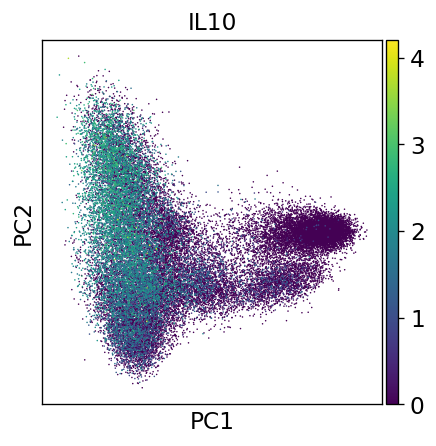

In [17]:
sc.pl.pca(adata, color = ['IL10'], add_outline=False, projection = '2d')

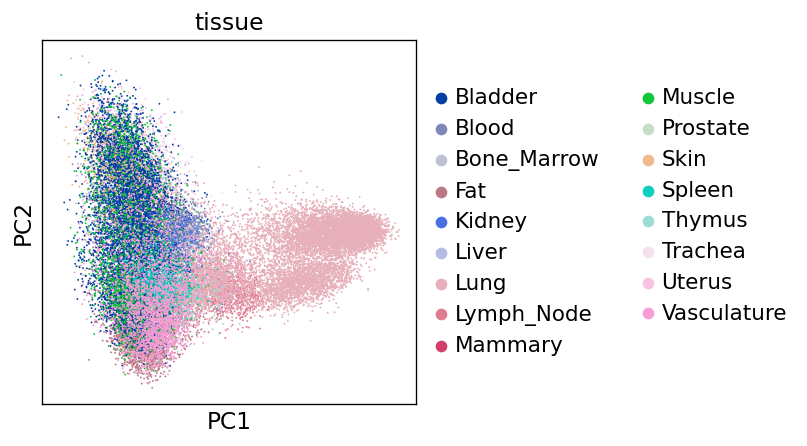

In [18]:
sc.pl.pca(adata, color = ['tissue'], add_outline=False, projection = '2d', size=5, save=
'macrophage_tissue', )

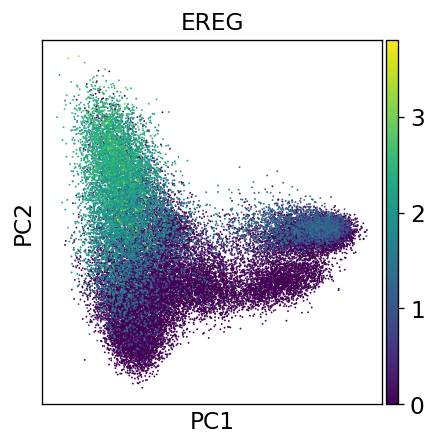

In [19]:
gene = 'EREG'
sc.pl.pca(adata, color = gene, add_outline=False, projection = '2d', size=5, save = 'macrophage'+gene)

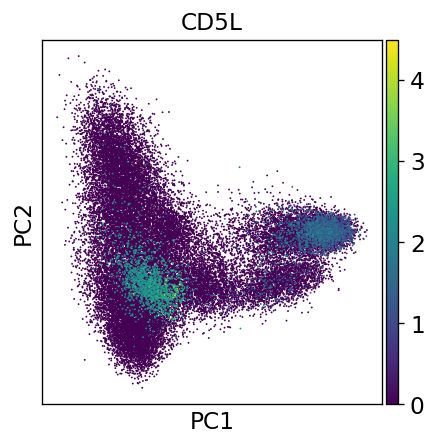

In [20]:
gene = "CD5L"
sc.pl.pca(adata, color = gene, add_outline=False, projection = '2d', size=5, save = 'macrophage'+gene)

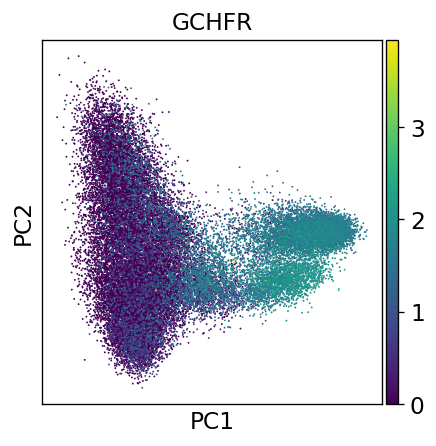

In [21]:
gene = "GCHFR"
sc.pl.pca(adata, color = gene, add_outline=False, projection = '2d', size=5, save = 'macrophage'+gene)

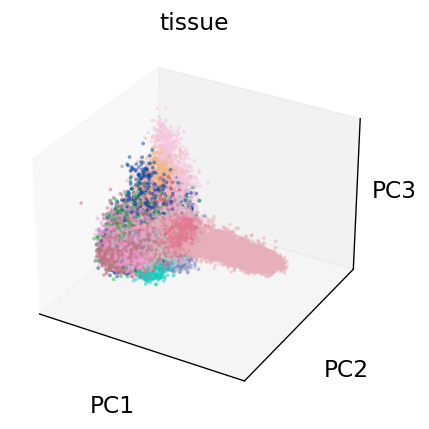

In [31]:
sc.pl.pca(adata, color = ['tissue'], add_outline=False, projection = '3d', size=60, alpha = 0.5, legend_loc=None)

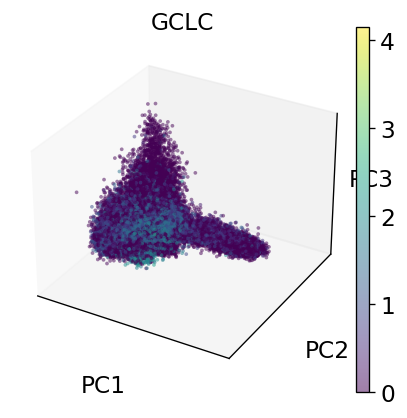

In [33]:
sc.pl.pca(adata, color = ['GCLC'], add_outline=False, projection = '3d', size=60, alpha = 0.5)

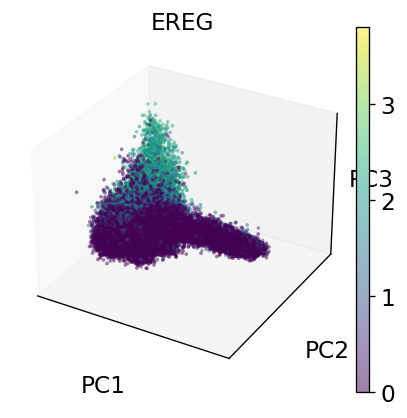

In [28]:
sc.pl.pca(adata, color = ['EREG'], add_outline=False, projection = '3d', size=60, alpha = 0.5, ncols=1)

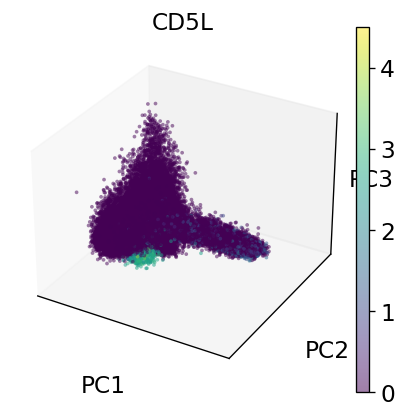

In [29]:
sc.pl.pca(adata, color = ['CD5L'], add_outline=False, projection = '3d', size=60, alpha = 0.5, ncols=1)

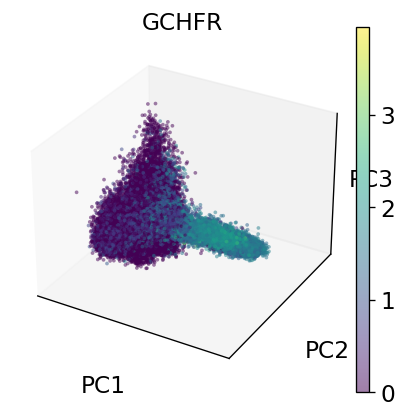

In [30]:
sc.pl.pca(adata, color = ['GCHFR'], add_outline=False, projection = '3d', size=60, alpha = 0.5, ncols=1)

In [ ]:
sc.pl.pca(adata, color = [''], add_outline=False, projection = '3d', size=60, alpha = 0.5, ncols=1)